<table width=100%>
<tr>
    <td><h1 style="text-align: left; font-size:300%;">
      Clustering model on expression level of mouse nuclear cortex proteins
    </h1></td>
    <td width="20%">
    <div style="text-align: right">
    <b> Machine Learning 2022</b> <br>
    Arianna Febbo <br>
    Daniele Pittari <br>
    <a href="mailto:arianna.febbo@mail.polimi.it">arianna.febbo@mail.polimi.it</a><br>
    <a href="mailto:daniele.pittari@mail.polimi.it">daniele.pittari@mail.polimi.it</a><br>
    </div>
    </td>

</tr>
</table>

In [1]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"  
SEED=40

#%matplotlib inline
import pandas as pd
import numpy as np
import sklearn
import statsmodels.api as sm
import matplotlib.pyplot as plt
import seaborn as sns
from pandas.api.types import is_string_dtype, is_numeric_dtype
import scipy

np.random.seed(0)

# 1. Exploratory Data Analysis (EDA)

The aim of EDA in this analyitical context is to identify structures in the data. This may help in the decision of the analytical tools to use and during the step of clustering output intepreation. 

In our specific case, data visualization will help to visualize strucutres of the distint groups defined by the known labels. This will be the standard for a qualitative comparison of how well the structures defined by clustering algorithms tested reseble those defined by the labels.

In [2]:
df = pd.read_excel('Data_Cortex_Nuclear.xls')
df.head(5)
df.shape

,MouseID,DYRK1A_N,ITSN1_N,BDNF_N,NR1_N,NR2A_N,pAKT_N,pBRAF_N,pCAMKII_N,pCREB_N,...,pCFOS_N,SYP_N,H3AcK18_N,EGR1_N,H3MeK4_N,CaNA_N,Genotype,Treatment,Behavior,class
0,309_1,0.503644,0.747193,0.430175,2.816329,5.990152,0.218830,0.177565,2.373744,0.232224,...,0.108336,0.427099,0.114783,0.131790,0.128186,1.675652,Control,Memantine,C/S,c-CS-m
1,309_2,0.514617,0.689064,0.411770,2.789514,5.685038,0.211636,0.172817,2.292150,0.226972,...,0.104315,0.441581,0.111974,0.135103,0.131119,1.743610,Control,Memantine,C/S,c-CS-m
2,309_3,0.509183,0.730247,0.418309,2.687201,5.622059,0.209011,0.175722,2.283337,0.230247,...,0.106219,0.435777,0.111883,0.133362,0.127431,1.926427,Control,Memantine,C/S,c-CS-m
3,309_4,0.442107,0.617076,0.358626,2.466947,4.979503,0.222886,0.176463,2.152301,0.207004,...,0.111262,0.391691,0.130405,0.147444,0.146901,1.700563,Control,Memantine,C/S,c-CS-m
4,309_5,0.434940,0.617430,0.358802,2.365785,4.718679,0.213106,0.173627,2.134014,0.192158,...,0.110694,0.434154,0.118481,0.140314,0.148380,1.839730,Control,Memantine,C/S,c-CS-m


(1080, 82)

The data set consists of the expression levels of 77 proteins/protein modifications that produced detectable signals in the nuclear fraction of cortex. 

There are 38 control mice and 34 trisomic mice (Down syndrome), for a total of 72 mice. 

In the experiments, 15 measurements were registered of each protein per sample/mouse. Therefore, for control mice, there are 38x15, or 570 measurements, and for trisomic mice (Ts65DN), there are 34x15, or 510 measurements. The dataset contains a total of 1080 measurements per protein

In [3]:
df['Genotype'].value_counts()

Control    570
Ts65Dn     510
Name: Genotype, dtype: int64

In [4]:
df['class'].value_counts()

c-CS-m    150
c-SC-m    150
c-CS-s    135
c-SC-s    135
t-CS-m    135
t-SC-m    135
t-SC-s    135
t-CS-s    105
Name: class, dtype: int64

**Classes**:

**c-CS-s**: control mice, stimulated to learn, injected with saline (9 mice)

**c-CS-m**: control mice, stimulated to learn, injected with memantine (10 mice)

**c-SC-s**: control mice, not stimulated to learn, injected with saline (9 mice)

**c-SC-m**: control mice, not stimulated to learn, injected with memantine (10 mice)

**t-CS-s**: trisomy mice, stimulated to learn, injected with saline (7 mice)

**t-CS-m**: trisomy mice, stimulated to learn, injected with memantine (9 mice)

**t-SC-s**: trisomy mice, not stimulated to learn, injected with saline (9 mice)

**t-SC-m**: trisomy mice, not stimulated to learn, injected with memantine (9 mice)

Filtering out the labels from the dataset.

In [5]:
df_filt = df.copy(deep=True)
df_filt = df_filt.drop(['MouseID', 'Genotype', 'Treatment', 'Behavior'], axis = 1)

In [6]:
y= df_filt['class']
X= df_filt.loc[:, df_filt.columns != 'class']

print("X.shape ", X.shape)
print("y.shape ", y.shape)
X

X.shape  (1080, 77)
y.shape  (1080,)


,DYRK1A_N,ITSN1_N,BDNF_N,NR1_N,NR2A_N,pAKT_N,pBRAF_N,pCAMKII_N,pCREB_N,pELK_N,...,SHH_N,BAD_N,BCL2_N,pS6_N,pCFOS_N,SYP_N,H3AcK18_N,EGR1_N,H3MeK4_N,CaNA_N
0,0.503644,0.747193,0.430175,2.816329,5.990152,0.218830,0.177565,2.373744,0.232224,1.750936,...,0.188852,0.122652,NaN,0.106305,0.108336,0.427099,0.114783,0.131790,0.128186,1.675652
1,0.514617,0.689064,0.411770,2.789514,5.685038,0.211636,0.172817,2.292150,0.226972,1.596377,...,0.200404,0.116682,NaN,0.106592,0.104315,0.441581,0.111974,0.135103,0.131119,1.743610
2,0.509183,0.730247,0.418309,2.687201,5.622059,0.209011,0.175722,2.283337,0.230247,1.561316,...,0.193685,0.118508,NaN,0.108303,0.106219,0.435777,0.111883,0.133362,0.127431,1.926427
3,0.442107,0.617076,0.358626,2.466947,4.979503,0.222886,0.176463,2.152301,0.207004,1.595086,...,0.192112,0.132781,NaN,0.103184,0.111262,0.391691,0.130405,0.147444,0.146901,1.700563
4,0.434940,0.617430,0.358802,2.365785,4.718679,0.213106,0.173627,2.134014,0.192158,1.504230,...,0.205604,0.129954,NaN,0.104784,0.110694,0.434154,0.118481,0.140314,0.148380,1.839730
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1075,0.254860,0.463591,0.254860,2.092082,2.600035,0.211736,0.171262,2.483740,0.207317,1.057971,...,0.275547,0.190483,NaN,0.115806,0.183324,0.374088,0.318782,0.204660,0.328327,1.364823
1076,0.272198,0.474163,0.251638,2.161390,2.801492,0.251274,0.182496,2.512737,0.216339,1.081150,...,0.283207,0.190463,NaN,0.113614,0.175674,0.375259,0.325639,0.200415,0.293435,1.364478
1077,0.228700,0.395179,0.234118,1.733184,2.220852,0.220665,0.161435,1.989723,0.185164,0.884342,...,0.290843,0.216682,NaN,0.118948,0.158296,0.422121,0.321306,0.229193,0.355213,1.430825
1078,0.221242,0.412894,0.243974,1.876347,2.384088,0.208897,0.173623,2.086028,0.192044,0.922595,...,0.306701,0.222263,NaN,0.125295,0.196296,0.397676,0.335936,0.251317,0.365353,1.404031


<ins>**Checking for missing values**</ins>

The total number of NAs in the dataset is: 1396


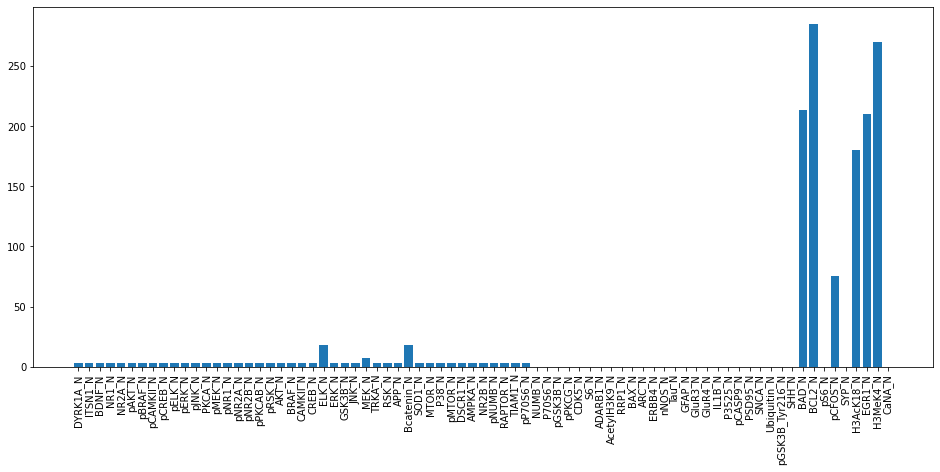

In [7]:
missing=X.isnull().sum()
print("The total number of NAs in the dataset is:" , missing.sum())

# Plotting the number of NAs per 
fig = plt.figure(figsize=(12.5, 5));
ax = fig.add_axes([0,0,1,1]);
NAs = missing;
genes = missing.keys();
plt.bar( genes, NAs);
plt.xticks(rotation=90);
#plt.plot(NAs,genes)
plt.show();

### NA values heandling approach:
1. Remotion of features with more than 1% NA values
2. kNN Imputation for the remaining missing values 

In [8]:
from sklearn.impute import KNNImputer

# 1. Filtering features
X_filtered = X.drop(missing[missing>1088*5/100].keys(), axis = 1)
X_filtered.shape

# 2. Imputation
imputer = KNNImputer(n_neighbors=3)
imputed = imputer.fit_transform(X_filtered)
X_imputed = pd.DataFrame(imputed, columns=X_filtered.columns)


X_imputed.isnull().sum().sum()


(1080, 71)

0

## 1.1 Data visualization - Dimensionality Reduction

The aim of EDA in the context of unsupervised clustering is to highlight underlying patterns in the data. To do this, we will utilize PCA and UMAP to perform dimensionality reduction.


<ins>**Principal Components Analysis**<ins>

We use PCA to inspect of how samples are organized based their condition by viasualizing how they are distributed in a reduced space. 
We will visualize 3 dimension, and in order to do that we have to convert the original dataset features into 3 new ones. Before performing the visualization, we performed the inspection of the variance explained by the principal components, since it indicates us how "informative" our 3D visualization will be in terms of variance explained.

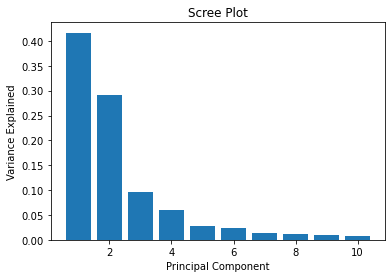

In [9]:
import plotly.express as px
from sklearn.decomposition import PCA

# Define PCA with 3 components, this will transform 
pca = PCA(n_components=10)
# Reduce features dimensionality, just for visualization
# purpuses
X = pca.fit_transform(X_imputed)

PC_values = np.arange(pca.n_components_) + 1;
plt.bar( PC_values, pca.explained_variance_ratio_);
plt.title('Scree Plot');
plt.xlabel('Principal Component');
plt.ylabel('Variance Explained');
plt.show();

Observation: the first 2 components alone explain approximately 70% of the variance

<ins>**Uniform Manifold Approximation and Projection (UMAP)**<ins>

UMAP, differently from PCA, is a nonlinear dimensionality reduction method, it is very effective for visualizing clusters or groups of data points and their relative proximities.

### 1.1.1 Data visualization - Single variables (learning, tratment, genotype)

<ins>**PCA: labels for exposure to learning**</ins>

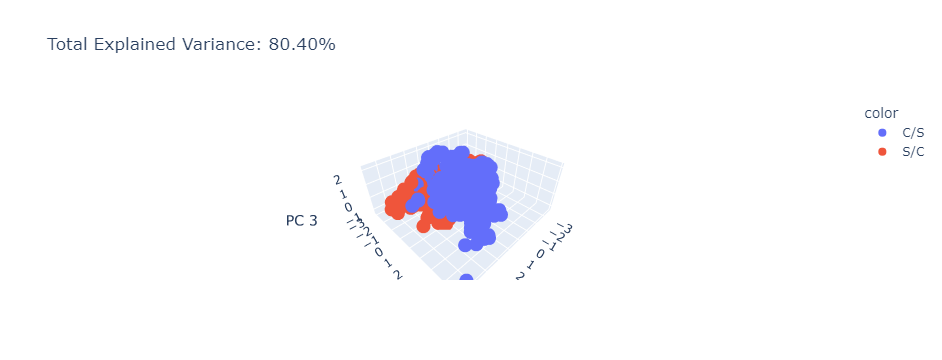

In [10]:
pca= PCA(n_components=3)
X = pca.fit_transform(X_imputed)

total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    X, x=0, y=1, z=2, color=df['Behavior'],
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

<ins>**UMAP: labels for exposure to learning**</ins>

<AxesSubplot:>

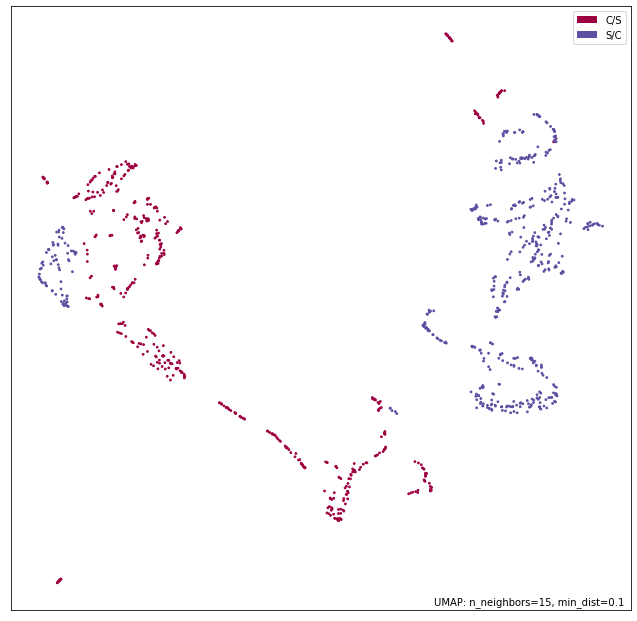

In [11]:
import umap
import umap.plot
mapper = umap.UMAP(random_state=SEED).fit(X_imputed)
umap.plot.points(mapper, labels=df['Behavior'])

**Observation**:  Behaviour shows a well defined separation in the first three PCs as well as in UMAP space.

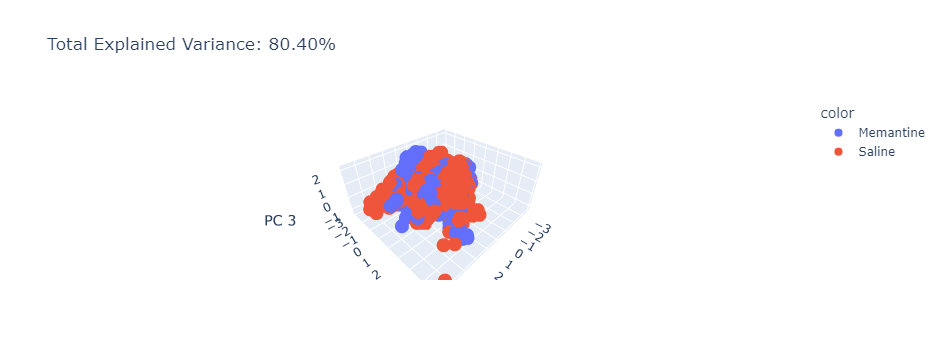

In [12]:
fig = px.scatter_3d(
    X, x=0, y=1, z=2, color=df['Treatment'],
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

<ins>**UMAP: labels for treatment**</ins>

<AxesSubplot:>

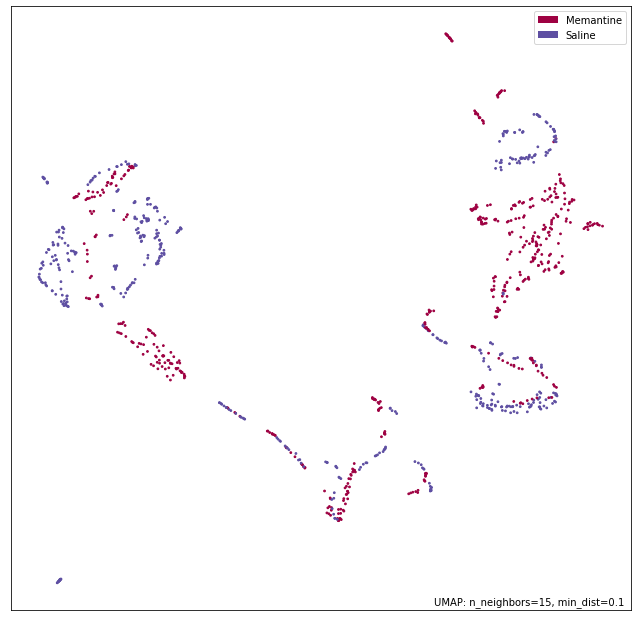

In [13]:
mapper = umap.UMAP(random_state=SEED).fit(X_imputed)
umap.plot.points(mapper, labels=df['Treatment'])

**Observation**:  Treatment shows observation with more complex separation in the first three PCs as well as in UMAP space. However, the different partitions of spaces in which Memantine or Saline obs disply relative homogeneity.

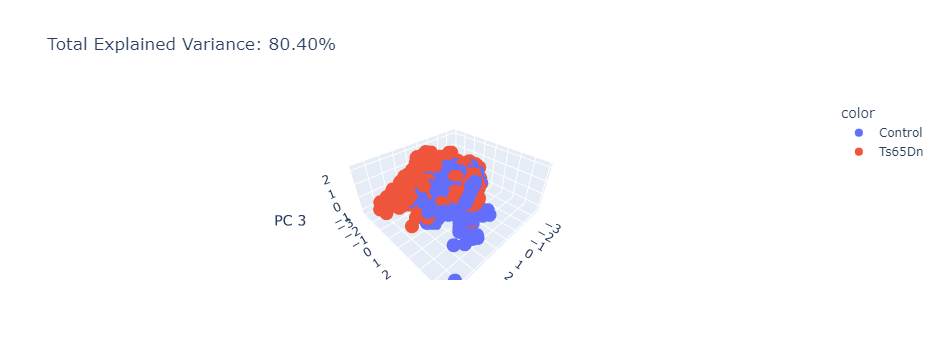

In [14]:
fig = px.scatter_3d(
    X, x=0, y=1, z=2, color=df['Genotype'],
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

<AxesSubplot:>

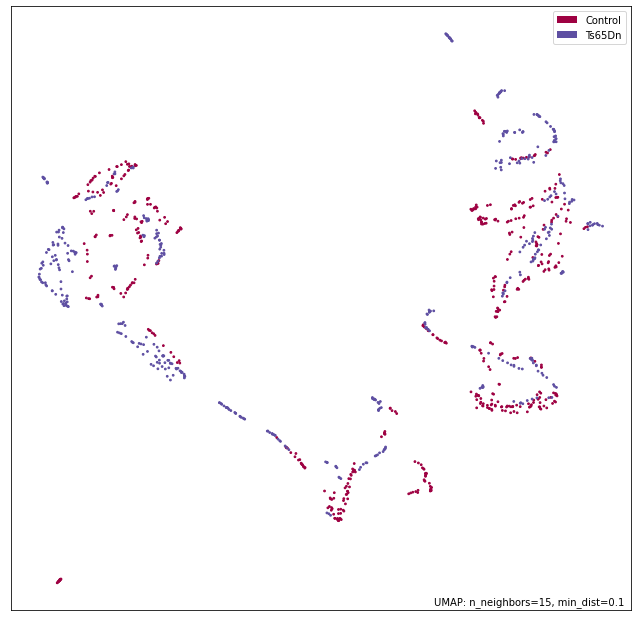

In [15]:
mapper = umap.UMAP(random_state=SEED).fit(X_imputed)
umap.plot.points(mapper, labels=df['Genotype'])

**Observation**: Genotype shows observation less distinc separation and higher heterogeneity.

### 1.1.2 Data visualization - Combined: learning, tratment, genotype 
Class to be dissected from data using clustering techniques

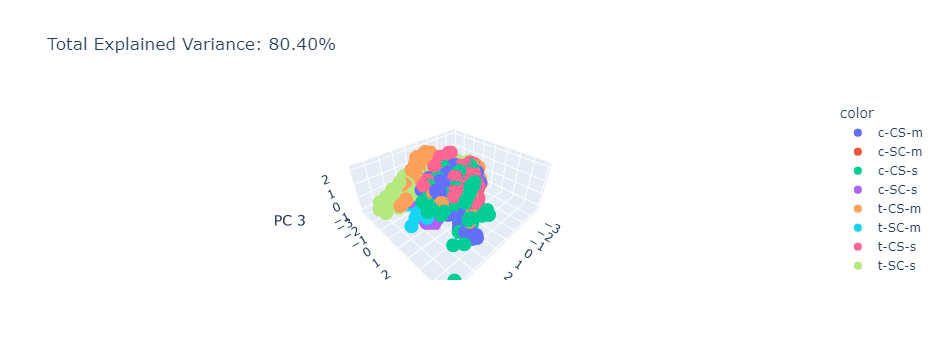

In [16]:
fig = px.scatter_3d(
    X, x=0, y=1, z=2, color=df['class'],
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

<AxesSubplot:>

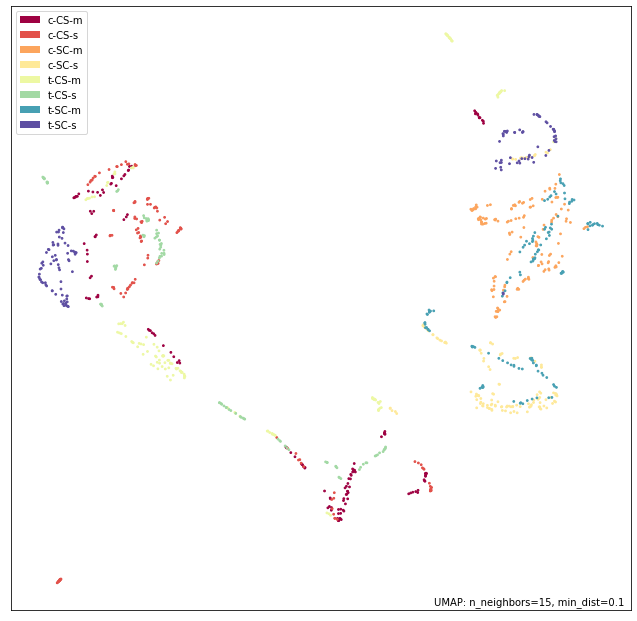

In [17]:
mapper = umap.UMAP(random_state=SEED).fit(X_imputed)
umap.plot.points(mapper, labels=df['class'])

**Observation**:  treatment + genotype + learning shows observation with the most complex spatial organization in the first three PCs as well as in UMAP space. Despite what observed for Memantine or Saline, some grups do not show particular homogeneity in their spatial localization compared to other conditions (eg. c-CS-m). 

## 2.1 Hierarchical clustering (HC)

### 2.1.1 Linkage Matrix


In [18]:
from scipy.cluster.hierarchy import dendrogram, linkage

# Generate the linkage matrix
Z = linkage(X_imputed, metric='euclidean', method='ward')
print("X.shape", X_imputed.shape)
Z[:10]

X.shape (1080, 71)


array([[9.90000000e+01, 1.00000000e+02, 1.30810436e-01, 2.00000000e+00],
       [6.60000000e+01, 6.70000000e+01, 1.30866236e-01, 2.00000000e+00],
       [9.12000000e+02, 9.13000000e+02, 1.36935933e-01, 2.00000000e+00],
       [4.35000000e+02, 4.36000000e+02, 1.37376703e-01, 2.00000000e+00],
       [9.60000000e+01, 9.70000000e+01, 1.37903700e-01, 2.00000000e+00],
       [1.95000000e+02, 1.96000000e+02, 1.54176466e-01, 2.00000000e+00],
       [5.40000000e+01, 5.50000000e+01, 1.57184967e-01, 2.00000000e+00],
       [9.57000000e+02, 9.58000000e+02, 1.57518085e-01, 2.00000000e+00],
       [2.55000000e+02, 2.56000000e+02, 1.59013107e-01, 2.00000000e+00],
       [4.63000000e+02, 4.64000000e+02, 1.63801040e-01, 2.00000000e+00]])

A $(N-1) \times 4$ matrix Z is returned. At the $i$-th iteration, clusters with indices Z[i, 0] and Z[i, 1] are combined to form cluster $N + i$ .
A cluster with an index less than $N$ corresponds to one of the $N$ original observations. 

The distance between clusters Z[i, 0] and Z[i, 1] is given by Z[i, 2]. 

The fourth value Z[i, 3] represents the number of original observations in the newly formed cluster.

So at line 0 we are inspecting sample id **99** and **100**, which are the two most similar points in the dataset and are being merged by the algorithm.

A $(N-1) \times 4$ matrix Z is returned. At the $i$-th iteration, clusters with indices Z[i, 0] and Z[i, 1] are combined to form cluster $N + i$ .
A cluster with an index less than $N$ corresponds to one of the $N$ original observations. 

The distance between clusters Z[i, 0] and Z[i, 1] is given by Z[i, 2]. 

The fourth value Z[i, 3] represents the number of original observations in the newly formed cluster.

So at line 0 we are inspecting sample id **99** and **100**, which are the two most similar points in the dataset and are being merged by the algorithm.

In [19]:
# Inspect one of these lines to verify 
print(Z[380])
print(Z[61])

[5.88000000e+02 1.27100000e+03 4.03358541e-01 3.00000000e+00]
[184.         185.           0.21206958   2.        ]


Line 380 merges id **380**, which is < 1080, with id **1721**, which is > 1080. To reconstruct which was cluster **1721** we inspected line **1721 - 1080**.

Line 380 merges id **380**, which is < 1080, with id **1721** , which is > 1080. To reconstruct which was cluster **1721** we inspected line **1721 - 1080**.

### 2.1.2  Dendrograms visualization

Thanks to the linkage matrix, it's possible to plot the dendogram, which is very useful for inspecting the hierarchy and sequence of merges.

In [20]:
from scipy.cluster.hierarchy import dendrogram

def plot_dendrogram(Z=None, model=None, X=None, **kwargs):
    annotate_above = kwargs.pop('annotate_above', 0)

    # Reconstruct the linakge matrix if the standard model API was used
    if Z is None:
        if hasattr(model, 'distances_') and model.distances_ is not None:
            # create the counts of samples under each node
            counts = np.zeros(model.children_.shape[0])
            n_samples = len(model.labels_)
            for i, merge in enumerate(model.children_):
                current_count = 0
                for child_idx in merge:
                    if child_idx < n_samples:
                        current_count += 1  # leaf node
                    else:
                        current_count += counts[child_idx - n_samples]
                counts[i] = current_count

            Z = np.column_stack([model.children_, model.distances_,
                                              counts]).astype(float)
        else:
            Z = linkage(X, method=model.linkage, metric=model.affinity)
    
    if 'n_clusters' in kwargs:
        n_clusters = kwargs.pop('n_clusters')
        # Set the cut point just above the last but 'n_clusters' merge
        kwargs['color_threshold'] = Z[-n_clusters, 2] + 1e-6
    
    fig = plt.figure(figsize=(20,10))
    ax = fig.add_subplot(111)
    # Plot the corresponding dendrogram
    ddata = dendrogram(Z, ax=ax, **kwargs) 
    
    # Annotate nodes in the dendrogram
    for i, d, c in zip(ddata['icoord'], ddata['dcoord'], ddata['color_list']):
        x = 0.5 * sum(i[1:3])
        y = d[1]
        nid = np.where(Z[:,2] == y)[0][0]
        if y > annotate_above:
            plt.plot(x, y, 'o', c=c)
            plt.annotate(str(nid-Z.shape[0]), (x, y), xytext=(0, -5),
                         textcoords='offset points',
                         va='top', ha='center')
    if kwargs['color_threshold']:
        plt.axhline(y=kwargs['color_threshold'], c='k')
    
    return fig, ax

We will explore all the different options in order to decide which clusters have to merge first. 
The strategies are: 


- **Complete** (maximal intercluster distance): Compute all distances between points in cluster A and cluster B and return the *largest of these distances*.
- **Single** (minimal intercluster distance): As before, but we return the *smallest distance*.
- **Average/Median** (mean intercluster distance): As before, but we return the *average/median of the distances*.
- **Centroid**: We compute the distance of the two clusters as the distance between the two clusters means/centroids.
- **Ward** (minimal inter-cluster variance): Finds the pair of clusters that leads to *minimum increase in total within-cluster variance after merging*

Text(0.5, 1.0, 'single')

Text(0.5, 1.0, 'average')

Text(0.5, 1.0, 'complete')

Text(0.5, 1.0, 'centroid')

Text(0.5, 1.0, 'ward')

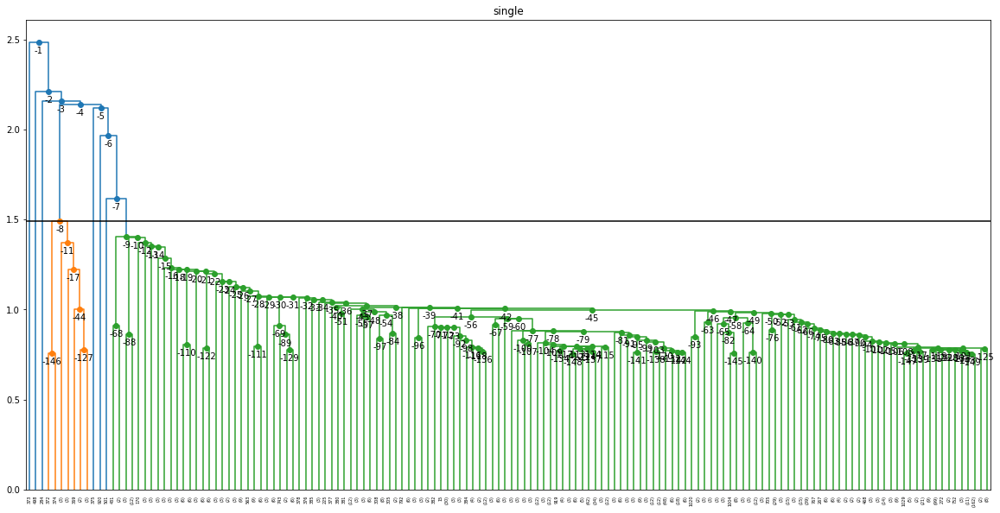

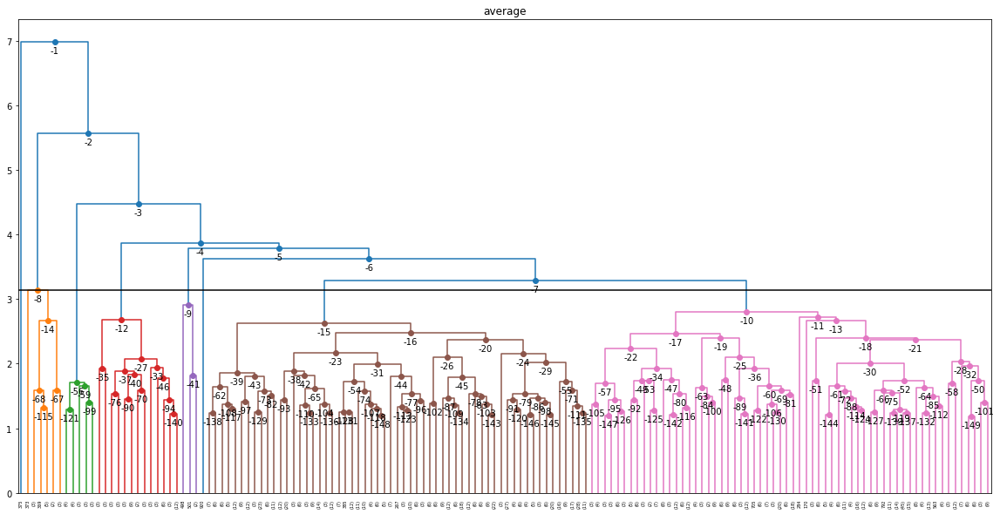

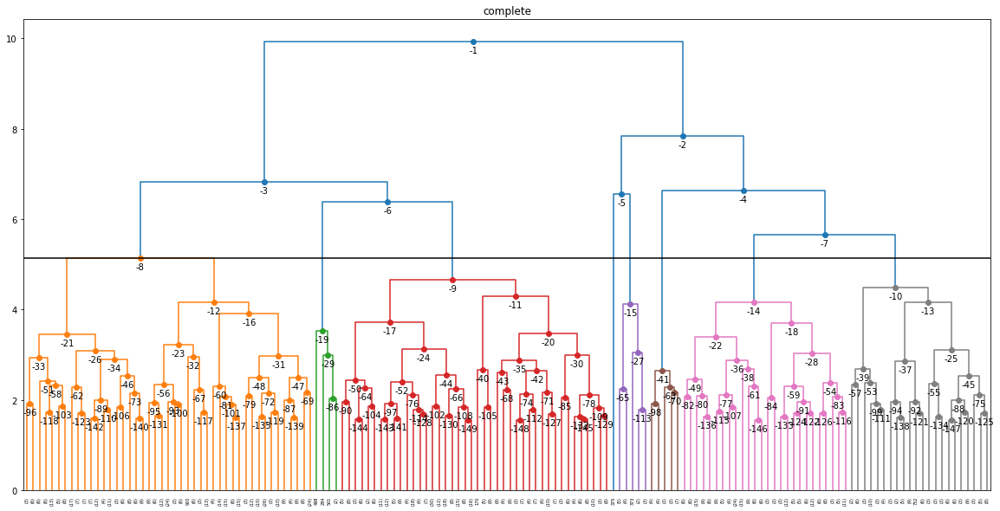

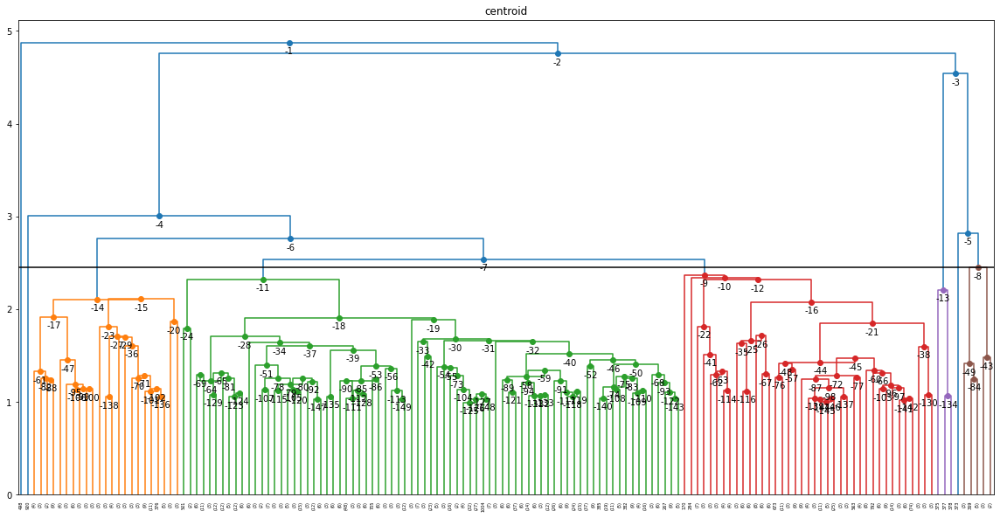

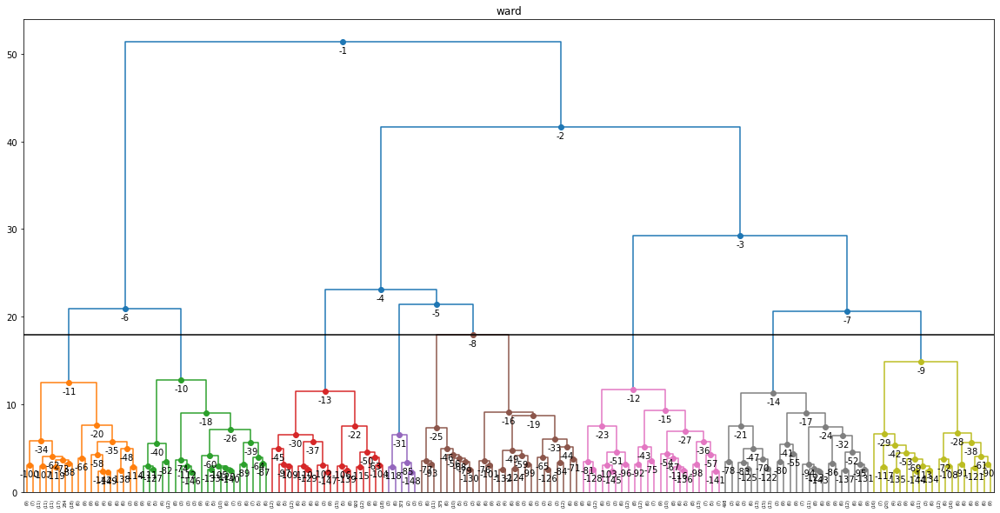

In [21]:
# Plot the dendrogram, showing ony the ast 100 merges
# and cutting the dendrogram so that we obtain 8 clusters
methods = ['single', 'average', 'complete', 'centroid', 'ward']

for method in methods:
    Z = linkage(X_imputed, metric='euclidean', method=method)
    fig, ax = plot_dendrogram(Z=Z, X=X_imputed, truncate_mode='lastp', p=150,n_clusters=8)
    ax.set_title(method)

As expected the linkage methods **ward** is the one performing better, since it is able to detect more clusters than any of the other methods. However, it must be noticed that one of the clusters is comprehensive of few points, when instead the cluster compared to the other ones must be balanced according to the column 'class' (smaller cluster of 105 obs, and bigger cluster of 150 obs.)

In fact, **single** linkage is the one providing smaller jumps among all, detecting a small amount of clusters.

**Complete** linkage provides larger jumps than single and avarage, and it is also able to provide 8 clusters. Still they look unbalanced in the number of points included in each cluster.

**Centroid** linkage suffer of inversions.

The dendogram it is not very informative since it's hard to determine which are the samples grouped inside each of the clusters.
However the linkage matrix can be used to reconstruct the set of points belonging to each cluster thanks to fcluster function.

In [22]:
np.set_printoptions(threshold=np.inf)
from scipy.cluster.hierarchy import fcluster
Z = linkage(X_imputed, metric='euclidean', method='ward')
k=8
clusters = fcluster(Z, k, criterion='maxclust')

In [23]:
clusters

array([5, 5, 5, 3, 3, 3, 3, 3, 3, 6, 6, 6, 6, 6, 6, 5, 5, 5, 5, 3, 3, 3,
       3, 3, 3, 3, 3, 6, 6, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 3, 3, 3, 3, 3, 3, 7, 7, 7, 7, 7, 7,
       7, 7, 7, 7, 7, 7, 7, 7, 7, 5, 5, 5, 5, 5, 5, 5, 5, 5, 8, 8, 8, 6,
       6, 6, 5, 5, 5, 8, 8, 8, 8, 8, 8, 8, 8, 8, 6, 6, 6, 5, 5, 5, 3, 3,
       3, 3, 3, 3, 6, 6, 6, 6, 6, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 8, 8, 8,
       8, 8, 8, 5, 5, 5, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 2, 2, 2, 1, 1, 1, 8, 8, 8, 8, 8, 8, 8, 8, 8, 1, 1, 1,
       8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 1, 1, 1, 1, 1, 8, 8, 8, 8, 8,
       8, 8, 8, 8, 8, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 8, 8, 8, 8, 8, 2, 2,
       2, 2, 1, 1, 1, 1, 1, 8, 8, 8, 6, 6, 6, 7, 7, 7, 8, 8, 8, 8, 8, 8,
       6, 6, 6, 6, 6, 6, 2, 2, 2, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2,
       2, 2, 7, 7, 7, 7, 7, 7, 8, 8, 8, 8, 8, 8, 5,

In [24]:
len(clusters)
import collections
counter = collections.Counter(clusters)
counter

1080

Counter({5: 143, 3: 144, 6: 167, 7: 176, 8: 163, 1: 153, 2: 119, 4: 15})

As expected the cluster 4 has much fewer observations (15) compared to the other ones. And this information does not get along with the data collected in column 'class'.

### 2.1.3 Agglomerative clustering 

Agglomerative or bottom-up clustering is the most common type of hierarchical clustering used to group objects in clusters based on their similarity. It starts by treating each object as a singleton cluster,  and, at each step, joining two closest clusters.

Our previous inspections of dendograms created with different linkage methods suggested the ward linkage being the one better reflecting the structure (at least in the number of elements separated) of each class in the data. 

In [25]:
from sklearn.cluster import AgglomerativeClustering
distance_threshold=None#270
n_clusters=8

# Computing HC using euclidean distance and ward linkage
model = AgglomerativeClustering(n_clusters=n_clusters, 
                                distance_threshold=distance_threshold, 
                                affinity='euclidean', linkage='ward',
                                compute_distances=True)

y_predict = model.fit_predict(X_imputed)


# Computing HC using euclidean distance and ward linkage
model_complete = AgglomerativeClustering(n_clusters=n_clusters, 
                                distance_threshold=distance_threshold, 
                                affinity='euclidean', linkage='complete',
                                compute_distances=True)

y_predict_complete = model_complete.fit_predict(X_imputed)


In [26]:
X_imputed_clust = df.copy(deep=True)
clusters_agg = pd.DataFrame(y_predict)
X_imputed_clust["Cluster"] = clusters_agg



<ins>**PCA and UMAP: labels for clusters assigned by HC (euclidean distance, ward distance)**</ins>

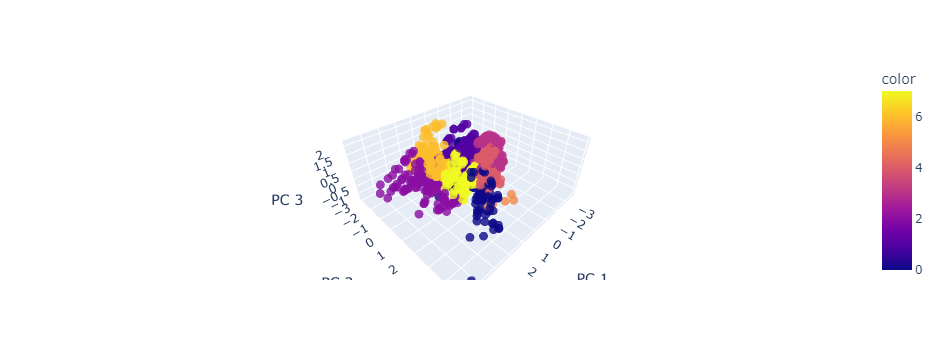

<AxesSubplot:>

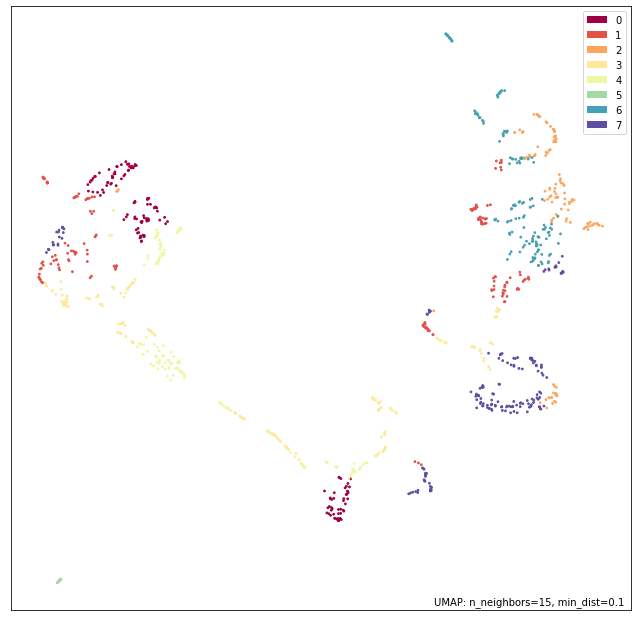

In [27]:
fig = px.scatter_3d(
    X, x=0, y=1, z=2, color=y_predict,
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'},
    opacity=0.8
)
fig.update_traces(marker_size = 5)
umap.plot.points(mapper, labels=y_predict)

<ins>**PCA and UMAP: labels for clusters assigned by HC (euclidean distance, complete linkage)**</ins>

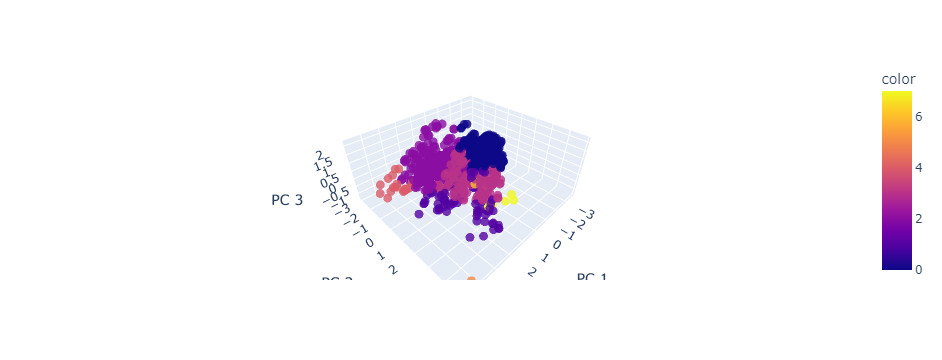

<AxesSubplot:>

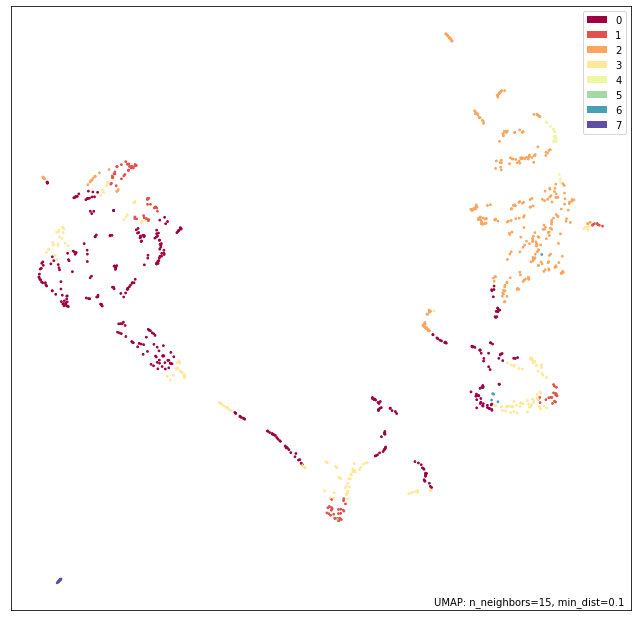

In [28]:
fig = px.scatter_3d(
    X, x=0, y=1, z=2, color=y_predict_complete,
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'},
    opacity=0.8
)
fig.update_traces(marker_size = 5)
umap.plot.points(mapper, labels=y_predict_complete)

**Observation:** PCA and UMAP overlayed with HC cluster output labels show that clusters do not seem to reflect well the shape of the known structure, particularly for the complete linkage method. It seems evident how assigment into clusters reflects mainly the distances of the point, coherently with the fact that we utilized the euclidean measure to compute distances. We also tested the performance of HC using the pearson correlation coefficient and complete linkage but the results seem not satisfying (data not presented). 

### 2.1.4 Evaluation of quality mesures for HC (euclidean , ward / complete)

Here we determine the quality of our previous clusters.

This evaluation would be formed based on:

1. Internal validation: Based on the information intrinsic to the data alone.
2. External validation: Based on previous knowledge about data.


### 2.1.4.1 Evaluation of quality mesures for HC - Internal quality 

This answers to the second task of the project: in this step we will consider cluster quality in the sense of the capacity to cluster "similar" elements (regardless the real element of interest, in this case the class. We will quantify it later in 2.1.4.2).

**<ins>Silhouette score</ins>**

The Silhouette Score computes the compactness of individual clusters and separation amongst clusters to quantify an overall representative clustering performance score.

In [29]:
y_rand = np.random.randint(0, 8, y.shape[0]);
from sklearn.metrics import silhouette_score
print( "Silhouette score of HC, ward linkage is:", silhouette_score(X_imputed, y_predict) )
print( "Silhouette score of HC, complete linkage is:", silhouette_score(X_imputed, y_predict_complete) )
print(" ")
print("Not great results ... but what about the original class?")
print( "Silhouette score of the original class is:", silhouette_score(X_imputed, df['class']) )
print(" ")
print("... and the Silhouette score of random clusters?")
print( "Silhouette score of random clusters:", silhouette_score(X_imputed, y_rand ))

Silhouette score of HC, ward linkage is: 0.16257638073380717
Silhouette score of HC, complete linkage is: 0.17295389265308017
 
Not great results ... but what about the original class?
Silhouette score of the original class is: -0.011038453015638815
 
... and the Silhouette score of random clusters?
Silhouette score of random clusters: -0.0404602452613426


**Comment:** The Silhouette score of the original class is close to zero. This means that many points lyies in the decision boundary between clusters. This is coherent with what observed in our PCA exploration during EDA. Trying to achieve a better score would not be in line with the goal to obtain the same clusters defined by class. Indeed, not all the groups defined by the class did not seem to have a "modular" structure. On the other hand, shilouette score for HC suggests that HC mildy improves the differentiation between the clusters.

In [30]:
from sklearn.metrics import pairwise_distances
from sklearn.preprocessing import normalize

def incidence_mat(y_pred):
    npoints = y_pred.shape[0]
    mat = np.zeros([npoints, npoints])
    # Retrieve how many different cluster ids there are
    clusters = np.unique(y_pred)
    nclusters = clusters.shape[0]
    
    for i in range(nclusters):
        sample_idx = np.where(y_pred == i)
        # Compute combinations of these indices
        idx = np.meshgrid(sample_idx, sample_idx)
        mat[idx[0].reshape(-1), idx[1].reshape(-1)] = 1
        
    return mat

def similarity_mat(X, metric):
    dist_mat = pairwise_distances(X, metric=metric)
    min_dist, max_dist = dist_mat.min(), dist_mat.max()
    
    # Normalize distances in [0, 1] and compute the similarity
    sim_mat = 1 - (dist_mat - min_dist) / (max_dist - min_dist)
    return sim_mat

def correlation(X, y_pred, metric):
    inc = incidence_mat(y_pred)
    sim = similarity_mat(X, metric)
    
    # Note: we can eventually remove duplicate values
    # only the upper/lower triangular matrix
    # triuidx = np.triu_indices(y_pred.shape[0], k=1)
    # inc = inc[triuidx]
    # sim = sim[triuidx]
    
    inc = normalize(inc.reshape(1, -1))
    sim = normalize(sim.reshape(1, -1))
    corr = (inc @ sim.T)
    return corr[0,0]   

**<ins>Cluster validity via correlation</ins>**

In [31]:
print( "HC, ward linkage, clustering correlation based on euclidean dist is:", correlation(X_imputed, y_predict, 'euclidean') )
print( "HC, complete linkage, clustering correlation based on euclidean dist is:", correlation(X_imputed, y_predict_complete, 'euclidean')  )
print( "Class, clustering correlation based on euclidean dist is:", correlation(X_imputed, df['class'], 'euclidean')  )

print( " ")
print( "HC, ward linkage, clustering correlation based on manhattan dist is:", correlation(X_imputed, y_predict, 'manhattan') )
print( "HC, complete linkage, clustering correlation based on manhattan dist is:", correlation(X_imputed, y_predict_complete, 'manhattan')  )
print( "Class, clustering correlation based on manhattan dist is:", correlation(X_imputed, df['class'], 'manhattan')  )


HC, ward linkage, clustering correlation based on euclidean dist is: 0.43173908271638095
HC, complete linkage, clustering correlation based on euclidean dist is: 0.5861579380502345
Class, clustering correlation based on euclidean dist is: 0.0
 
HC, ward linkage, clustering correlation based on manhattan dist is: 0.4233640575231563
HC, complete linkage, clustering correlation based on manhattan dist is: 0.5721734153176078
Class, clustering correlation based on manhattan dist is: 0.0


### Similarity matrix

It's used to look at how far are points within the same cluster from each other. Rows and coluns are ordered such as the points belonging to the same cluster id are close to each other.

This means that the similarity matrix should appear as formed by squares that arrange along the main diagonal.

We define the incidence matrix as an  𝑁×𝑁  matrix (where N is the number of sampes) having a  1  in position  (𝑖,𝑗)  if the samples  𝑖  and  𝑗  have the same predicted cluster id.

We define the similarity matrix as an  𝑁×𝑁  matrix containing the similarity ( 1−𝑑𝑖𝑠𝑡𝑎𝑛𝑐𝑒 ) between each pair of points

In [32]:
def sorted_sim(sim, y_pred):
    idx_sorted = np.argsort(y_pred)
    # Sort the rows
    sim = sim[idx_sorted]
    # Sort the columns
    sim = sim[:, idx_sorted]
    
    return sim

def plot_sorted_mat(sim, y_pred):
    sim = sorted_sim(sim, y_pred)
    
    fig, ax = plt.subplots(figsize=(40,30))  
    ax = sns.heatmap(sim, ax=ax)
    # Remove ruler (ticks)
    ax.set_yticks([]) 
    ax.set_xticks([])

**<ins>Ward linkage </ins>**

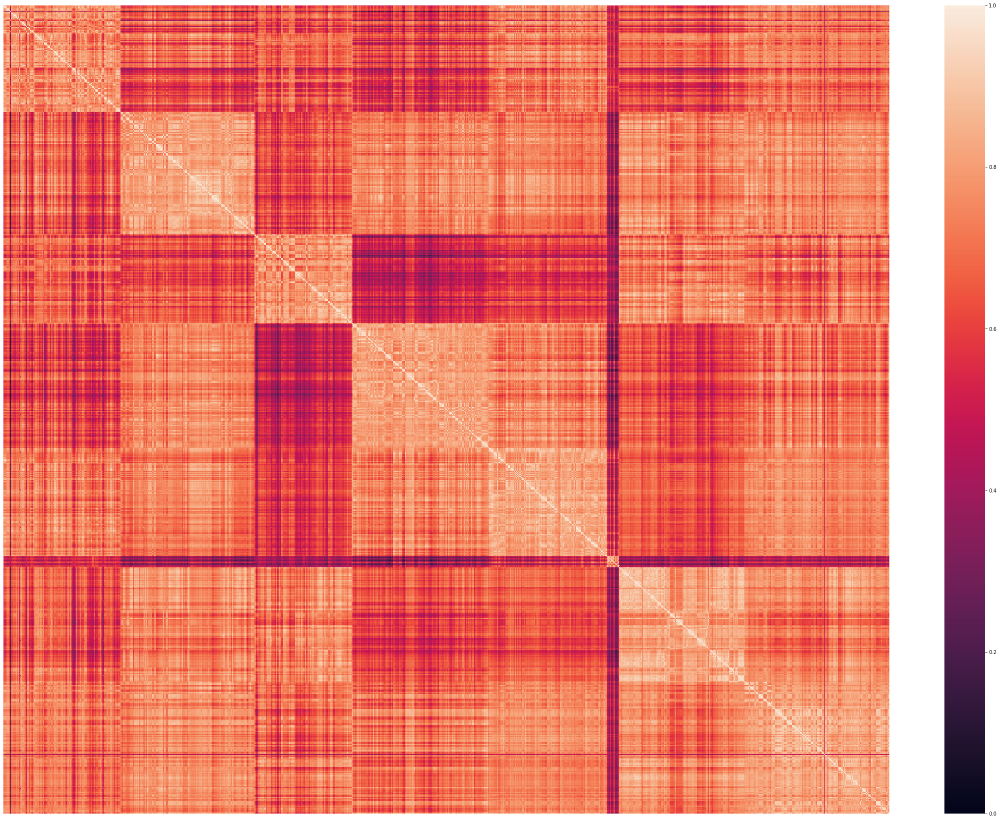

In [33]:
#euclidean distance
sim = similarity_mat(X_imputed, 'euclidean')
plot_sorted_mat(sim, y_predict)

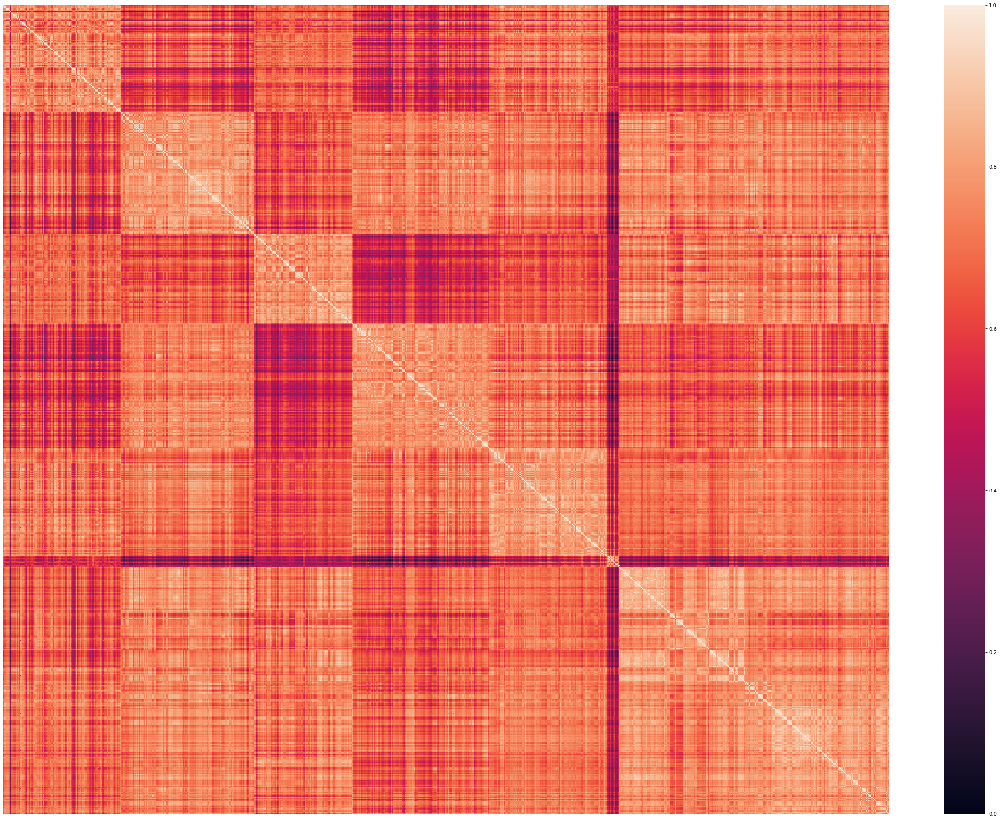

In [34]:
#manhattan distance
sim_manhattan = similarity_mat(X_imputed, 'manhattan')
plot_sorted_mat(sim_manhattan, y_predict)

In both cases the similarity matrix are generally formed by squares along the diagonal, but not a visible one in the bottom right corner.

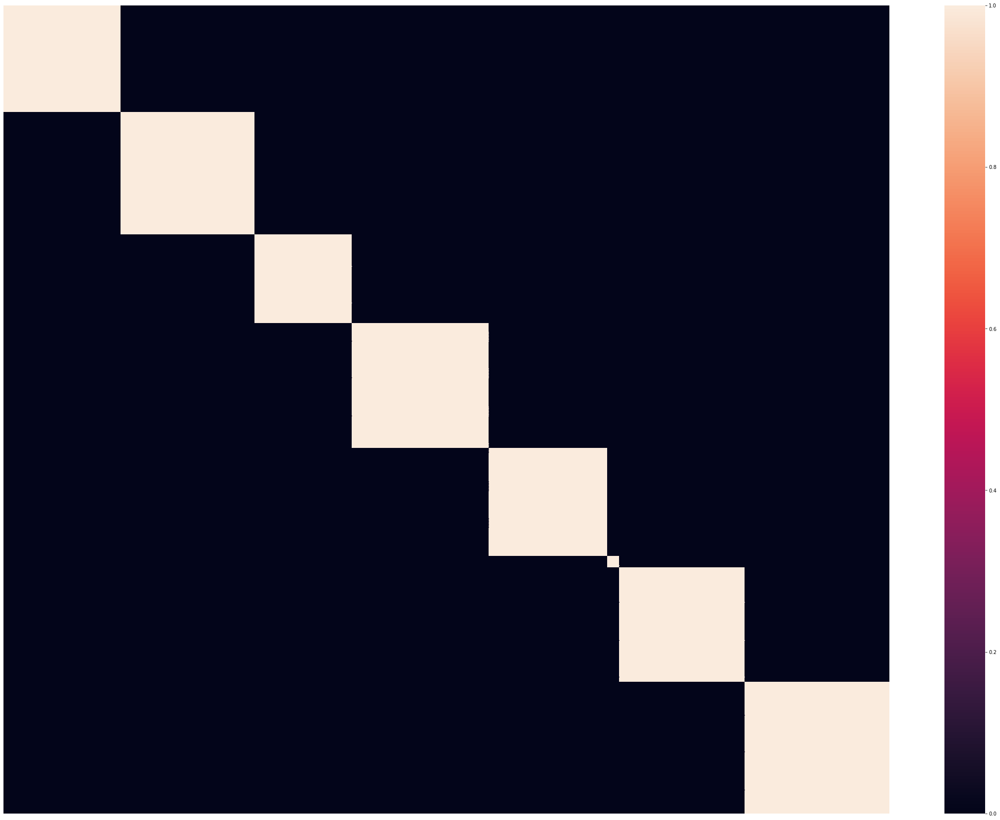

In [35]:
inc= incidence_mat(y_predict)
plot_sorted_mat(inc,y_predict)

Clearly the incidence matrix shows the bottom right cluster since the matrix is based on samples 𝑖 and 𝑗 that have the same predicted cluster id.

Therefore, points in the bottom right cluster are more distant from each other, than the points in other clusters.

**<ins>Complete linkage </ins>**

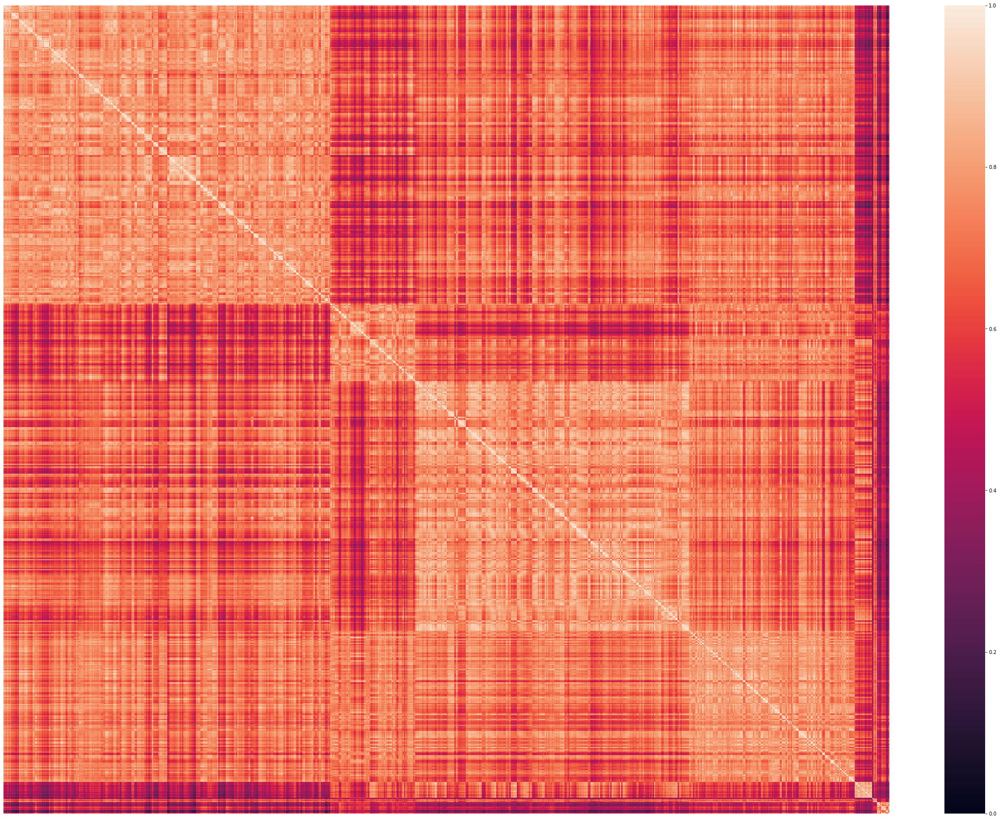

In [36]:
#euclidean distance
sim = similarity_mat(X_imputed, 'euclidean')
plot_sorted_mat(sim, y_predict_complete)

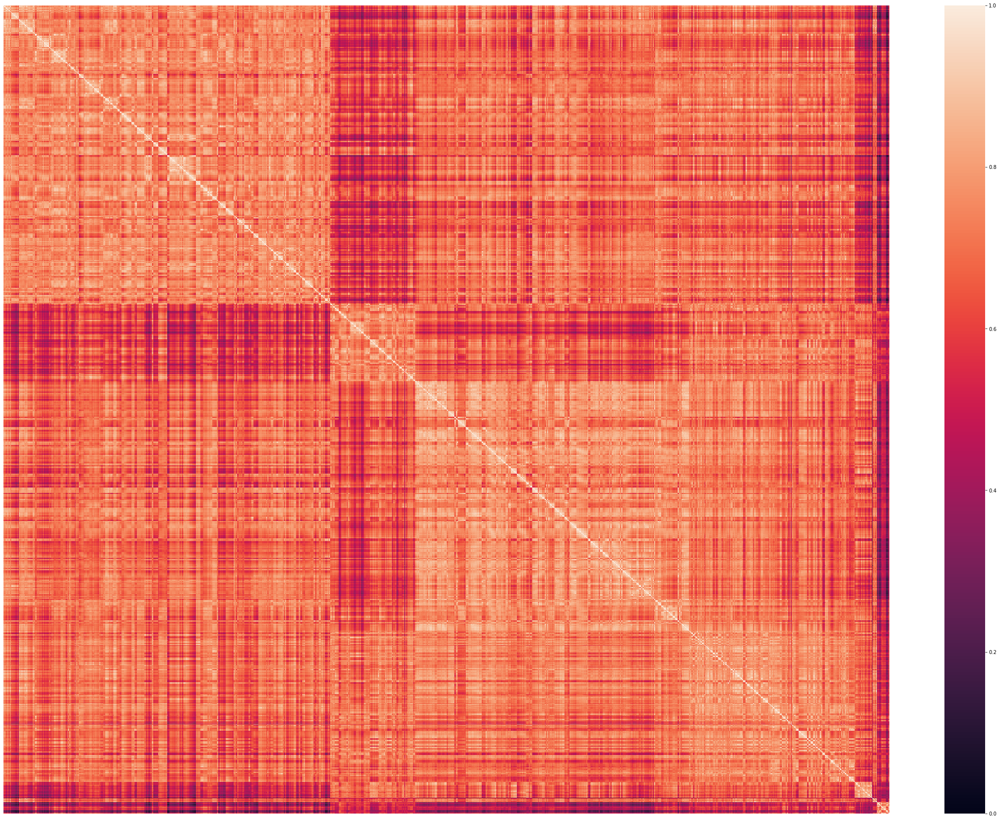

In [37]:
#manhattan distance
sim = similarity_mat(X_imputed, 'manhattan')
plot_sorted_mat(sim, y_predict_complete)

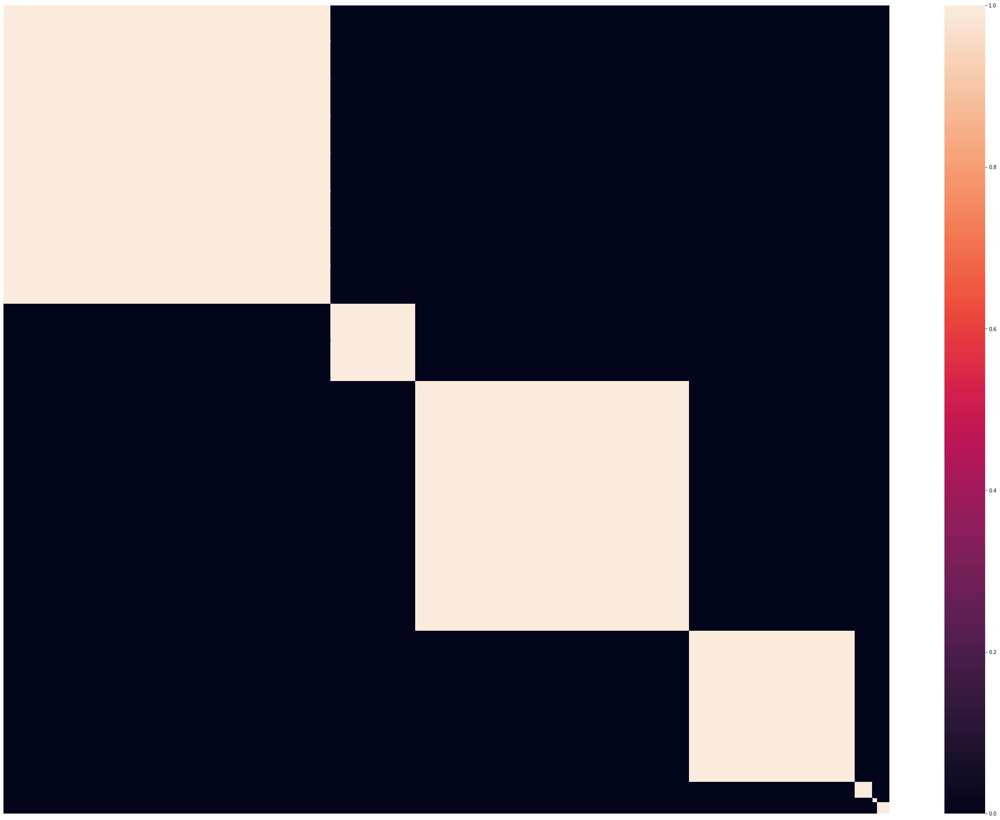

In [38]:
inc= incidence_mat(y_predict_complete)
plot_sorted_mat(inc,y_predict_complete)

The predicted clusters id in some cases are assigned to too many point, and in other cases to too few ones.

###  2.1.4.2 External quality measures evaluation: Precision, recall, purity and NMI

We will calculate the **<ins> purity of clustering</ins>** which can be computed just because we know the true cluster assignments.
The purity can be interpreted as a sort of accuracy in classification terms. So closer to one the better it is.

The other metric used to evaluate the performance of clustering is **<ins> NMI</ins>** (Normalized mutual information). It gives us the reduction in entropy of class labels when we are given the cluster labels. It can be interpreted as how much the uncertainty about class labels decreases when we know the cluster labels.

In [39]:

def get_Ncounts(y_predict, y_true, k, j=None):
    N = y_true.shape[0]
    Nk_mask = y_predict == k
    Nk = Nk_mask.sum()
    Nj, Nkj = None, None
    if j is not None:
        Nj_mask = y_true == j
        Nj = Nj_mask.sum()
        Nkj = np.logical_and(Nj_mask, Nk_mask).sum()
    return N, Nk, Nj, Nkj

def precision(y_predict, y_true, k, j):
    N, Nk, Nj, Nkj = get_Ncounts(y_predict, y_true, k, j)
    return Nkj / (Nk + 1e-8)
    
def recall(y_predict, y_true, k, j):
    N, Nk, Nj, Nkj = get_Ncounts(y_predict, y_true, k, j)
    return Nkj / (Nj + 1e-8)

def F(y_predict, y_true, k, j):
    p = precision(y_predict, y_true, k, j)
    r = recall(y_predict, y_true, k, j)
    return (2*p*r) / (p+r)

def purity(y_predict, y_true, k):
    cls = np.unique(y_true)
    prec = [precision(y_predict, y_true, k, j) for j in cls]
    return max(prec)

def tot_purity(y_predict, y_true):
    N = y_true.shape[0]
    nc = len(np.unique(y_true))
    p = 0
    for k in range(nc):
        N, Nk, _, _ = get_Ncounts(y_predict, y_true, k)
        pk = purity(y_predict, y_true, k)
        p += (Nk / N) * pk
    return p

from sklearn.metrics import normalized_mutual_info_score as nmi

**<ins>Assessing purity scores </ins>**

In [40]:
print( "The purity of HC, ward linkage output is:", tot_purity( y_predict , y) )
print( "The purity of HC, complete linkage output is:", tot_purity( y_predict_complete, y) )
print( "The purity random clusters output is:", nmi( df['class'], y_rand) )
print( " ")
print( "The NMI score of HC, ward linkage output is:", nmi( df['class'], y_predict) )
print( "The NMI score of HC, complete linkage output is:", nmi( df['class'], y_predict_complete) )
print( "The NMI score of random clusters is:", nmi( df['class'], y_rand) )

The purity of HC, ward linkage output is: 0.3527777777463035
The purity of HC, complete linkage output is: 0.2972222221795191
The purity random clusters output is: 0.009843106983734284
 
The NMI score of HC, ward linkage output is: 0.2612806973251155
The NMI score of HC, complete linkage output is: 0.1664420600637366
The NMI score of random clusters is: 0.009843106983734284


**Conclusion**: The quality measures indicates that the HC algoritm tested do not reflect those of the class we took into consideration.

## 2.2 K-means

K-means is a partitive clustering algorithm that allows to cluster the data into k clusters, which is one of the parameters to chose a priori. The alorithm utilziises centroids, which are randomly assigned at the first iteration, then the algorithm performs iterative computations of elements distance from centroids to re-assign their possition in order to optimize the positions of the centroids. Since intializaton of the algorithm may affect its performance (especially when centroids stardt near outliers), we utilized the kmeans++ algorthm, which should reduce the impact of this issue.



**<ins>Avg. Shilhouette score plot - identification of putative optimal K</ins>**
Partitive algorithms generally require to *se a priori* a number of k. Generally the decision of the optimal K number is guided by assumption that are based on the precise context of data analysis as well as internal clustering quality measures, generally the sum of squares or the average shilouette score for each K. 

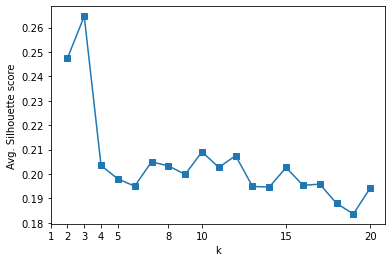

In [41]:
import numpy as np
import pandas as pd
import csv
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

score=[]

range_n_clusters=range(2,21)

for n_clusters in range_n_clusters:
    clusterer = KMeans(n_clusters=n_clusters,random_state=SEED );
    preds = clusterer.fit_predict(X_imputed);
    centers = clusterer.cluster_centers_;

    score.append(silhouette_score(X_imputed, preds));


plt.plot(range_n_clusters, score, marker='s');
plt.xticks([1,2,3,4,5,8,10,15,20]);
plt.ylabel('Avg. Silhouette score');
plt.xlabel('k');

The best clusters should have the highest scores, which is not the case for k = 8. 

**<ins>K means clustering, k=8 </ins>**

In [42]:
# random
km = KMeans(
    n_clusters=8, init='random', random_state=SEED
)
y_km = km.fit_predict(X_imputed);


#km++
km_plus = KMeans(
    n_clusters=8, init='k-means++', random_state=SEED
)
y_km_plus = km_plus.fit_predict(X_imputed);


y_km_char=np.array(y_km).astype('str').tolist();
y_km_plus_c=np.array(y_km_plus).astype('str').tolist();

**<ins>K means random</ins>**

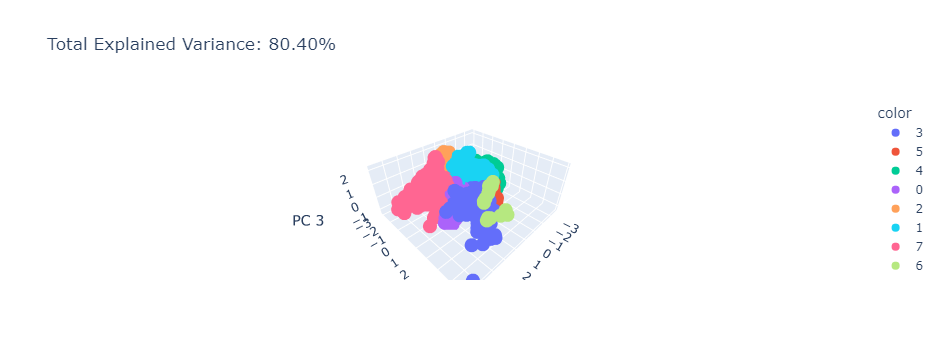

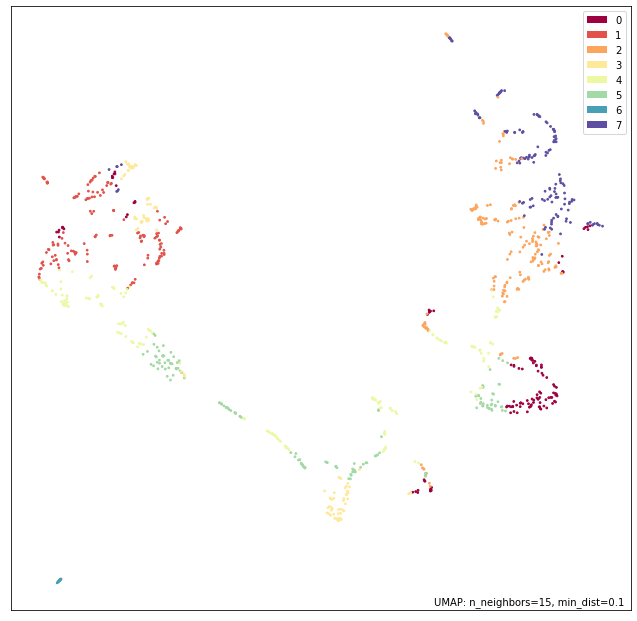

In [43]:
fig = px.scatter_3d(
    X, x=0, y=1, z=2, color=y_km_char,
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show();
umap.plot.points(mapper, labels=y_km);

**<ins>K means k++</ins>**

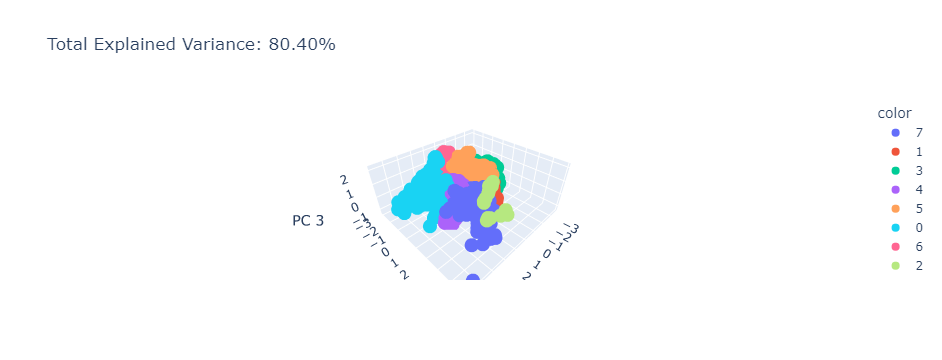

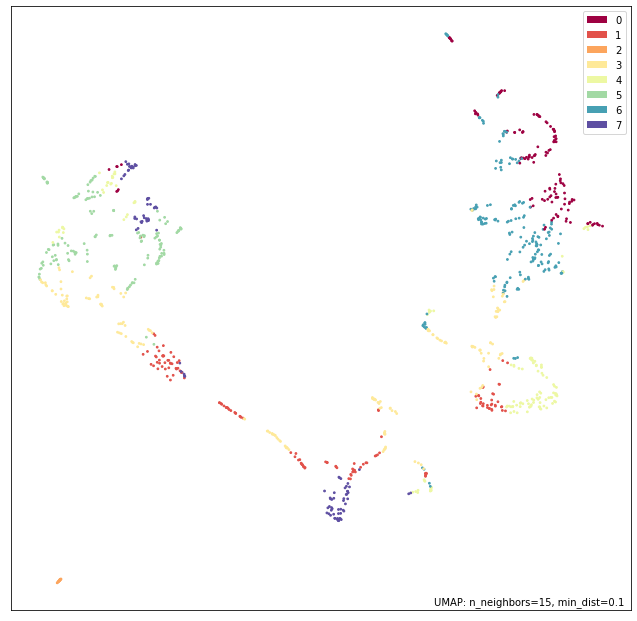

In [44]:
fig = px.scatter_3d(
    X, x=0, y=1, z=2, color=y_km_plus_c,
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show();
umap.plot.points(mapper, labels=y_km_plus);

**Observations:** both the outputs show very modular structures. This makes us speculate to obtain higher Shilouette scores but still very low external clustering quality values.

### 2.2.4.1 Evaluation of quality mesures for K means - Internal quality 

**<ins>Silhouette score</ins>**

In [45]:
print( "Silhouette score of K means output is:", silhouette_score(X_imputed, y_km) )
print( "Silhouette score of K means ++ output is:", silhouette_score(X_imputed, y_km_plus) )

Silhouette score of K means output is: 0.20719921749912093
Silhouette score of K means ++ output is: 0.2033112226389101


**<ins>Correlation</ins>**

In [46]:
print( "K-means clustering correlation based on euclidean dist is:", correlation(X_imputed, y_km, 'euclidean') )
print( "K-means ++ correlation based on euclidean dist is:", correlation(X_imputed, y_km_plus, 'euclidean')  )
print( " ")
print( "K-means clustering correlation based on manhattan dist is:", correlation(X_imputed, y_km, 'manhattan') )
print( "K-means ++ correlation based on manhattan dist is:", correlation(X_imputed, y_km_plus, 'manhattan')  )

K-means clustering correlation based on euclidean dist is: 0.44046851960207134
K-means ++ correlation based on euclidean dist is: 0.4413592608447308
 
K-means clustering correlation based on manhattan dist is: 0.42999489206088154
K-means ++ correlation based on manhattan dist is: 0.43087652680730265


###  2.2.4.2 External quality measures evaluation: Precision, recall, purity and NMI

In [47]:
print( "K-means clustering  output is:", tot_purity( y_km , y) )
print( "K-means clustering++ output is:", tot_purity( y_km_plus, y) )
print( " ")
print( "The NMI score of K-means clustering output is:", nmi( df['class'],y_km) )
print( "The NMI score of K-means++ clustering  output is:", nmi( df['class'], y_km_plus) )

K-means clustering  output is: 0.35555555552374424
K-means clustering++ output is: 0.3509259258943647
 
The NMI score of K-means clustering output is: 0.24539516086329868
The NMI score of K-means++ clustering  output is: 0.23979936410545383


Both K-means score similar to HC (euclidean distance, ward linkage).

## 2.3 DBSCAN

It's an algorithm for clustering based on density via density
connected points. It has 3 advantages:

- it does not need to know the number of cluster in advantage, information that we already know though;

- it can cluster arbitrary shapes;

- it is able to identify and handle outliers, as opposed to K-means which is too sensitive to outliers.

We have to provide an epsilon which defines the maximum distance between two points.
A valid value for epsilon can be found thanks to NearestNeighbors algorithm by calculating the distance to the nearest n points for each point and plotting the results, where the curve will be most pronounced (greatest change) and set that value as epsilon. 

In [48]:
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN

neigh = NearestNeighbors()
nbrs = neigh.fit(X_imputed)
distances, indices = nbrs.kneighbors(X_imputed)

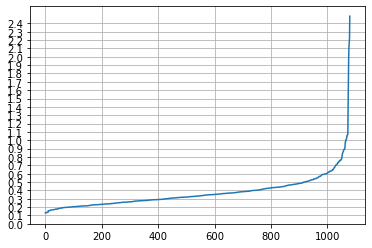

<Figure size 864x576 with 0 Axes>

In [49]:
distances = np.sort(distances, axis=0);
distances = distances[:,1];
plt.plot(distances);
plt.grid();
plt.yticks(np.arange(0, 2.5, step=0.1));
plt.figure(figsize=(12, 8));

We will set epsilon to 0.7.

In [50]:
model_DBSCAN = DBSCAN(eps=0.7, min_samples=5)
y_predict_DBSCAN = model_DBSCAN.fit_predict(X_imputed)
print("DBSCAN purity", tot_purity(y_predict_DBSCAN, y))
print("Number of outliers", (y_predict_DBSCAN == -1).sum())
ids, counts = np.unique(y_predict_DBSCAN, return_counts=True)
print(pd.DataFrame(counts.reshape(1,-1), columns=ids, index=['']))

DBSCAN purity 0.058333333263888884
Number of outliers 396
  -1    0    1    2    3    4    5    6    7    8   ...   50   51   52   53  \
  396    7    6   12   14    9    6    6    6    6  ...    6   13    9    5   

   54   55   56   57   58   59  
   18   16    6    8   16    6  

[1 rows x 61 columns]


The purity is very low and it creates too many clusters.

In [51]:
y_predict_DBSCAN_char=np.array(y_predict_DBSCAN).astype('str').tolist();


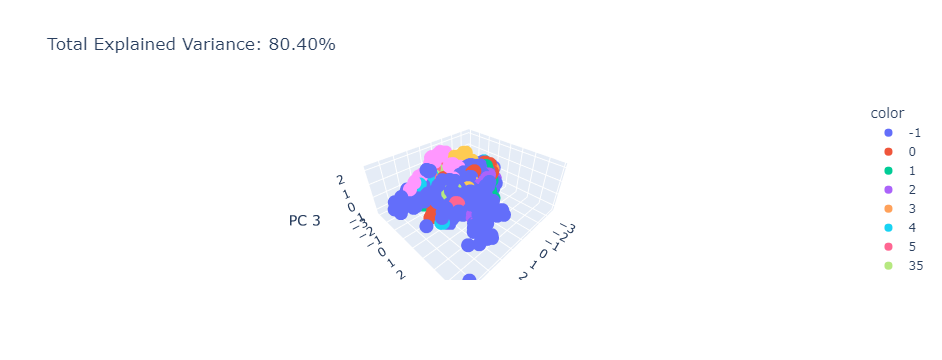

In [52]:
fig = px.scatter_3d(
    X, x=0, y=1, z=2, color=y_predict_DBSCAN_char,
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

Also we can use gridsearch cross-validation to select an hyperparameters combination that maximizes the purity.

In [53]:
def make_scorer(metric):
    def scorer(estimator, X, y):
        y_pred = estimator.fit_predict(X)
        return metric(y_pred, y)
    return scorer

In [54]:
from sklearn.model_selection import GridSearchCV

params = {'eps': range(1,20), 'min_samples': range(5,20)}
cv = GridSearchCV(DBSCAN(), params, scoring=make_scorer(tot_purity), cv=3)
cv = cv.fit(X_imputed, y)

In [55]:
print(cv.best_params_)
print("CV score", tot_purity(cv.best_estimator_.fit_predict(X_imputed), y))

pd.DataFrame(cv.cv_results_)

{'eps': 1, 'min_samples': 13}
CV score 0.24814814809962138


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_eps,param_min_samples,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,0.016023,0.000211,0.010826,3.674408e-03,1,5,"{'eps': 1, 'min_samples': 5}",0.191667,0.211111,0.080556,0.161111,0.057512,285
1,0.021258,0.003874,0.010659,3.778731e-03,1,6,"{'eps': 1, 'min_samples': 6}",0.177778,0.497222,0.077778,0.250926,0.178879,283
2,0.013341,0.003767,0.013327,3.767929e-03,1,7,"{'eps': 1, 'min_samples': 7}",0.158333,0.497222,0.066667,0.240741,0.185181,284
3,0.021339,0.007556,0.016220,1.162197e-02,1,8,"{'eps': 1, 'min_samples': 8}",0.175000,0.494444,0.283333,0.317593,0.132644,276
4,0.018669,0.003769,0.010664,3.767648e-03,1,9,"{'eps': 1, 'min_samples': 9}",0.225000,0.477778,0.263889,0.322222,0.111134,275
...,...,...,...,...,...,...,...,...,...,...,...,...,...
280,0.024001,0.000001,0.007999,4.089572e-06,19,15,"{'eps': 19, 'min_samples': 15}",0.416667,0.375000,0.375000,0.388889,0.019642,10
281,0.024002,0.000001,0.010669,3.769503e-03,19,16,"{'eps': 19, 'min_samples': 16}",0.416667,0.375000,0.375000,0.388889,0.019642,10
282,0.021505,0.003530,0.015999,8.920806e-07,19,17,"{'eps': 19, 'min_samples': 17}",0.416667,0.375000,0.375000,0.388889,0.019642,10
283,0.021328,0.003778,0.016013,6.538123e-03,19,18,"{'eps': 19, 'min_samples': 18}",0.416667,0.375000,0.375000,0.388889,0.019642,10


In [56]:
model_DBSCAN = DBSCAN(eps=1, min_samples=13)
y_predict_DBSCAN = model_DBSCAN.fit_predict(X_imputed)
print("Number of outliers", (y_predict_DBSCAN == -1).sum())
ids, counts = np.unique(y_predict_DBSCAN, return_counts=True)
print(pd.DataFrame(counts.reshape(1,-1), columns=ids, index=['']))

Number of outliers 381
   -1    0   1   2   3   4    5   6   7   8   9
  381  231  18  14   1  13  352  13  20  14  23


### 2.3.1 Evaluation of quality mesures for DBSCAN - Internal quality 

**<ins>Silhouette score</ins>**

In [57]:
print( "Silhouette score of DBSCAN output is:", silhouette_score(X_imputed, y_predict_DBSCAN) )

Silhouette score of DBSCAN output is: -0.1627184479580352


DBSCAN silhouette score is the worst one, among the investigated. And it's even worse in terms of overall quality of clusters than the one scored by random cluster.
This means that many points lyies in the decision boundary between clusters. This is coherent with what observed in our PCA exploration during EDA.


**<ins>Correlation</ins>**

In [58]:
print( "DBSCAN clustering correlation based on euclidean dist is:", correlation(X_imputed, y_predict_DBSCAN, 'euclidean') )
print( " ")
print( "DBSCAN clustering correlation based on manhattan dist is:", correlation(X_imputed, y_predict_DBSCAN, 'manhattan') )

DBSCAN clustering correlation based on euclidean dist is: 0.44178646491917334
 
DBSCAN clustering correlation based on manhattan dist is: 0.4405715622191336


The correlation is not very high, like with all the other cluster algorithm we've used.

###  2.3.2 External quality measures evaluation: Precision, recall, purity and NMI

In [59]:
print( "DBSCAN clustering  purity is:", tot_purity( y_predict_DBSCAN , y) )
print( " ")
print( "The NMI score of DBSCAN clustering output is:", nmi( df['class'],y_predict_DBSCAN) )

DBSCAN clustering  purity is: 0.24814814809962138
 
The NMI score of DBSCAN clustering output is: 0.33458662937308864


The purity is even lower than in the algorithms previously investigated. It indicates that the HC algoritm tested do not reflect those of the class we took into consideration.

In [60]:
y_predict_DBSCAN_char=np.array(y_predict_DBSCAN).astype('str').tolist();


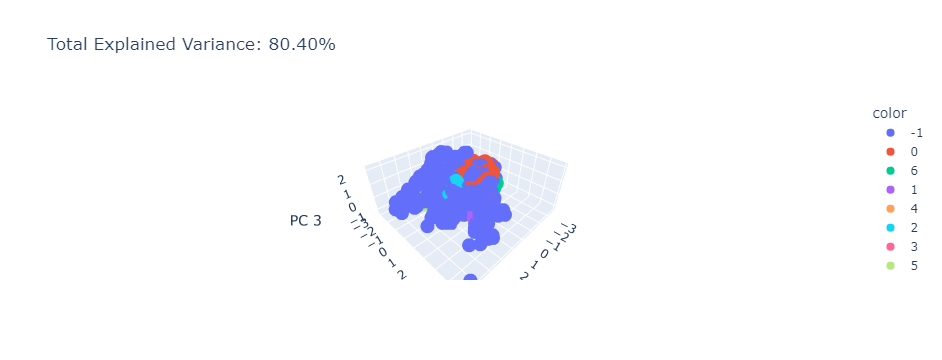

In [61]:
fig = px.scatter_3d(
    X, x=0, y=1, z=2, color=y_predict_DBSCAN_char,
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

# 3. Conclusion

All the clustering methods utilised could not efficiently capture structure in the data that are defined in the class of interest (genotype+learning+treatment). In this context, DBSCAN and K-means clustering outputs are the top models in terms of NMI score and purity, respectively.  

For what concerns the internal cluster validity, K-means returned clusters scoring the top value (0.2) for the shilouette score, suggesting the fact of not having obtained well-defined clusters, but it seems reasonable given the number of clusters we tried to obtain as well as the original hindered structure highlighted by dimensionality reduction.